In [1]:
!pip install plotly
!pip install wordcloud
!pip install langdetect

In [2]:
# Thư viện để đọc dataset
import numpy as np
import pandas as pd
# Thư viện để trực quan hóa dữ liệu
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)

from wordcloud import WordCloud
from langdetect import detect
from datetime import datetime
import os
os.getcwd()

C:\Users\admin\AppData\Local\Programs\Python\Python39\lib\site-packages\scipy\__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.26.4
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


'E:\\anime-recommand-scheduling\\notebooks'

# Đọc dataset

In [3]:
# Đọc dataset anime
pd.set_option('display.max_columns', 50)
df_anime=pd.read_csv('../data/all_animes.csv', low_memory=True)
print("Shape of the dataset: ", df_anime.shape)
df_anime.head(3)

Shape of the dataset:  (25230, 37)


,Unnamed: 0,mal_id,url,images,trailer,approved,titles,title,title_english,title_japanese,title_synonyms,type,source,episodes,status,airing,aired,duration,rating,score,scored_by,rank,popularity,members,favorites,synopsis,background,season,year,broadcast,producers,licensors,studios,genres,explicit_genres,themes,demographics
0,0.0,1,https://myanimelist.net/anime/1/Cowboy_Bebop,{'jpg': {'image_url': 'https://cdn.myanimelist...,"{'youtube_id': 'gY5nDXOtv_o', 'url': 'https://...",True,"[{'type': 'Default', 'title': 'Cowboy Bebop'},...",Cowboy Bebop,Cowboy Bebop,カウボーイビバップ,[],TV,Original,26.0,Finished Airing,False,"{'from': '1998-04-03T00:00:00+00:00', 'to': '1...",24 min per ep,R - 17+ (violence & profanity),8.75,961998.0,46.0,43,1860401,82197,"Crime is timeless. By the year 2071, humanity ...",When Cowboy Bebop first aired in spring of 199...,spring,1998.0,"{'day': 'Saturdays', 'time': '01:00', 'timezon...","[{'mal_id': 23, 'type': 'anime', 'name': 'Band...","[{'mal_id': 102, 'type': 'anime', 'name': 'Fun...","[{'mal_id': 14, 'type': 'anime', 'name': 'Sunr...","[{'mal_id': 1, 'type': 'anime', 'name': 'Actio...",[],"[{'mal_id': 50, 'type': 'anime', 'name': 'Adul...",[]
1,1.0,5,https://myanimelist.net/anime/5/Cowboy_Bebop__...,{'jpg': {'image_url': 'https://cdn.myanimelist...,"{'youtube_id': None, 'url': None, 'embed_url':...",True,"[{'type': 'Default', 'title': 'Cowboy Bebop: T...",Cowboy Bebop: Tengoku no Tobira,Cowboy Bebop: The Movie,カウボーイビバップ 天国の扉,"[""Cowboy Bebop: Knockin' on Heaven's Door""]",Movie,Original,1.0,Finished Airing,False,"{'from': '2001-09-01T00:00:00+00:00', 'to': No...",1 hr 55 min,R - 17+ (violence & profanity),8.38,214828.0,191.0,618,377223,1578,"Another day, another bounty—such is the life o...",NaN,NaN,NaN,"{'day': None, 'time': None, 'timezone': None, ...","[{'mal_id': 14, 'type': 'anime', 'name': 'Sunr...","[{'mal_id': 15, 'type': 'anime', 'name': 'Sony...","[{'mal_id': 4, 'type': 'anime', 'name': 'Bones...","[{'mal_id': 1, 'type': 'anime', 'name': 'Actio...",[],"[{'mal_id': 50, 'type': 'anime', 'name': 'Adul...",[]
2,2.0,6,https://myanimelist.net/anime/6/Trigun,{'jpg': {'image_url': 'https://cdn.myanimelist...,"{'youtube_id': 'bJVyIXeUznY', 'url': 'https://...",True,"[{'type': 'Default', 'title': 'Trigun'}, {'typ...",Trigun,Trigun,トライガン,[],TV,Manga,26.0,Finished Airing,False,"{'from': '1998-04-01T00:00:00+00:00', 'to': '1...",24 min per ep,PG-13 - Teens 13 or older,8.22,372406.0,337.0,252,761732,15966,"Vash the Stampede is the man with a $$60,000,0...",The Japanese release by Victor Entertainment h...,spring,1998.0,"{'day': 'Thursdays', 'time': '01:15', 'timezon...","[{'mal_id': 123, 'type': 'anime', 'name': 'Vic...","[{'mal_id': 102, 'type': 'anime', 'name': 'Fun...","[{'mal_id': 11, 'type': 'anime', 'name': 'Madh...","[{'mal_id': 1, 'type': 'anime', 'name': 'Actio...",[],"[{'mal_id': 50, 'type': 'anime', 'name': 'Adul...","[{'mal_id': 27, 'type': 'anime', 'name': 'Shou..."


In [4]:
# Đọc dataset thông tin người dùng
df_user=pd.read_csv('../data/users-details-2023.csv', low_memory=True)
print("Shape of the Dataset:",df_user.shape)
df_user.head()

Shape of the Dataset: (731321, 16)


,Mal ID,Username,Gender,Birthday,Location,Joined,Days Watched,Mean Score,Watching,Completed,On Hold,Dropped,Plan to Watch,Total Entries,Rewatched,Episodes Watched
0,1,Xinil,Male,1985-03-04T00:00:00+00:00,California,2004-11-05T00:00:00+00:00,142.3,7.37,1.0,233.0,8.0,93.0,64.0,399.0,60.0,8458.0
1,3,Aokaado,Male,NaN,"Oslo, Norway",2004-11-11T00:00:00+00:00,68.6,7.34,23.0,137.0,99.0,44.0,40.0,343.0,15.0,4072.0
2,4,Crystal,Female,NaN,"Melbourne, Australia",2004-11-13T00:00:00+00:00,212.8,6.68,16.0,636.0,303.0,0.0,45.0,1000.0,10.0,12781.0
3,9,Arcane,NaN,NaN,NaN,2004-12-05T00:00:00+00:00,30.0,7.71,5.0,54.0,4.0,3.0,0.0,66.0,0.0,1817.0
4,18,Mad,NaN,NaN,NaN,2005-01-03T00:00:00+00:00,52.0,6.27,1.0,114.0,10.0,5.0,23.0,153.0,42.0,3038.0


In [5]:
# Đọc dataset chấm điểm của người dùng
df_score=pd.read_csv('../data/users-score-2023.csv', low_memory=True)
print("Shape of the dataset:",df_score.shape)
df_score.head()

Shape of the dataset: (24326332, 5)


,user_id,Username,anime_id,Anime Title,rating
0,1,Xinil,21,One Piece,9
1,1,Xinil,48,.hack//Sign,7
2,1,Xinil,320,A Kite,5
3,1,Xinil,49,Aa! Megami-sama!,8
4,1,Xinil,304,Aa! Megami-sama! Movie,8


# Phân tích dữ liệu

In [7]:
df_anime.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25230 entries, 0 to 25229
Data columns (total 37 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Unnamed: 0       25147 non-null  float64
 1   mal_id           25230 non-null  int64  
 2   url              25230 non-null  object 
 3   images           25230 non-null  object 
 4   trailer          25230 non-null  object 
 5   approved         25230 non-null  bool   
 6   titles           25230 non-null  object 
 7   title            25230 non-null  object 
 8   title_english    10732 non-null  object 
 9   title_japanese   25134 non-null  object 
 10  title_synonyms   25230 non-null  object 
 11  type             25147 non-null  object 
 12  source           25230 non-null  object 
 13  episodes         24632 non-null  float64
 14  status           25230 non-null  object 
 15  airing           25230 non-null  bool   
 16  aired            25230 non-null  object 
 17  duration    

In [8]:
# Tiền xử lý dữ liệu cột score
df_anime['score'].fillna("UNKNOWN", inplace=True)
df_anime.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25230 entries, 0 to 25229
Data columns (total 37 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Unnamed: 0       25147 non-null  float64
 1   mal_id           25230 non-null  int64  
 2   url              25230 non-null  object 
 3   images           25230 non-null  object 
 4   trailer          25230 non-null  object 
 5   approved         25230 non-null  bool   
 6   titles           25230 non-null  object 
 7   title            25230 non-null  object 
 8   title_english    10732 non-null  object 
 9   title_japanese   25134 non-null  object 
 10  title_synonyms   25230 non-null  object 
 11  type             25147 non-null  object 
 12  source           25230 non-null  object 
 13  episodes         24632 non-null  float64
 14  status           25230 non-null  object 
 15  airing           25230 non-null  bool   
 16  aired            25230 non-null  object 
 17  duration    

In [8]:
df_anime['score'].value_counts()

UNKNOWN    9400
6.32         89
6.13         83
6.05         80
6.29         80
           ... 
3.72          1
3.29          1
2.76          1
3.37          1
8.89          1
Name: score, Length: 562, dtype: int64

In [9]:
scores = df_anime['score'][df_anime['score'] != 'UNKNOWN']
scores = scores.astype('float')
score_mean= round(scores.mean() , 2)

In [10]:
df_anime['score'] = df_anime['score'].replace('UNKNOWN', score_mean)
df_anime['score'] = df_anime['score'].astype('float64')

In [11]:
# Tiền xử lý dữ liệu cột rank
df_anime['rank'].fillna("UNKNOWN", inplace=True)
df_anime['rank'].value_counts()

UNKNOWN    4511
14550.0       6
0.0           6
15954.0       5
5209.0        5
           ... 
13998.0       1
1027.0        1
18142.0       1
10537.0       1
19435.0       1
Name: rank, Length: 14233, dtype: int64

In [12]:
df_anime['rank'] = df_anime['rank'].replace('UNKNOWN', np.nan)
df_anime['rank'] = df_anime['rank'].astype('float64')

In [13]:
df_user.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 731321 entries, 0 to 731320
Data columns (total 16 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Mal ID            731321 non-null  int64  
 1   Username          731321 non-null  object 
 2   Gender            224386 non-null  object 
 3   Birthday          168069 non-null  object 
 4   Location          152809 non-null  object 
 5   Joined            731321 non-null  object 
 6   Days Watched      731313 non-null  float64
 7   Mean Score        731313 non-null  float64
 8   Watching          731313 non-null  float64
 9   Completed         731313 non-null  float64
 10  On Hold           731313 non-null  float64
 11  Dropped           731313 non-null  float64
 12  Plan to Watch     731313 non-null  float64
 13  Total Entries     731313 non-null  float64
 14  Rewatched         731313 non-null  float64
 15  Episodes Watched  731313 non-null  float64
dtypes: float64(10), int6

In [14]:
df_score.isnull().sum()

user_id        0
Username       0
anime_id       0
Anime Title    0
rating         0
dtype: int64

## Trực quan hóa dữ liệu

### Dataset Anime

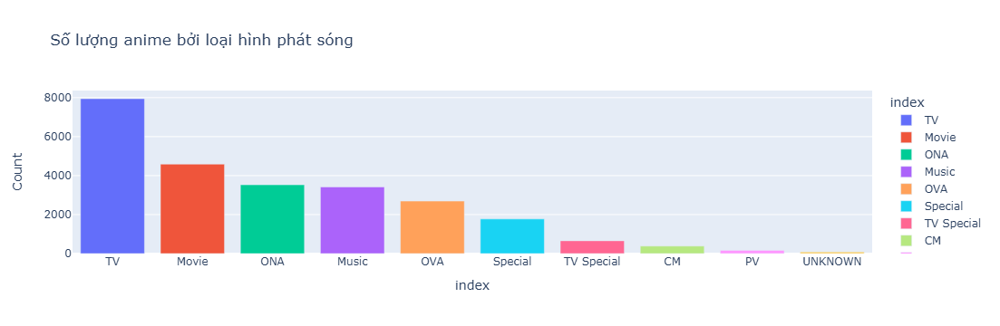

In [15]:
# Đếm số lượng anime bởi loại hình phát sóng
df_anime['type'].fillna("UNKNOWN", inplace=True)
type_counts = df_anime['type'].value_counts()

# Create a bar chart
fig = px.bar(type_counts, x=type_counts.index, y=type_counts.values, color=type_counts.index, labels={'x':'Anime Type', 'y':'Count'}, 
             title='Số lượng anime bởi loại hình phát sóng')

fig.show()

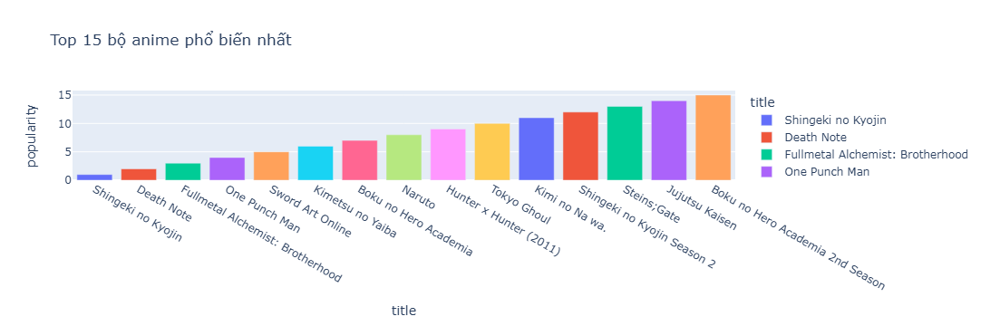

In [16]:
# Lọc những anime có độ phổ biến > 0
df_valid_popularity = df_anime[df_anime['popularity'] > 0]

# Lấy ra 15 anime phổ biến nhất
top_10_popular = df_valid_popularity.sort_values(by='popularity', ascending=True).head(15)

# Tạo biểu đồ cột
fig = px.bar(top_10_popular, x='title', y='popularity',
             labels={'Name': 'Anime Title', 'Popularity': 'Popularity'},
             title='Top 15 bộ anime phổ biến nhất',
             color='title')
# Note:- Thứ tự càng nhỏ độ phổ biến càng lớn
fig.show()

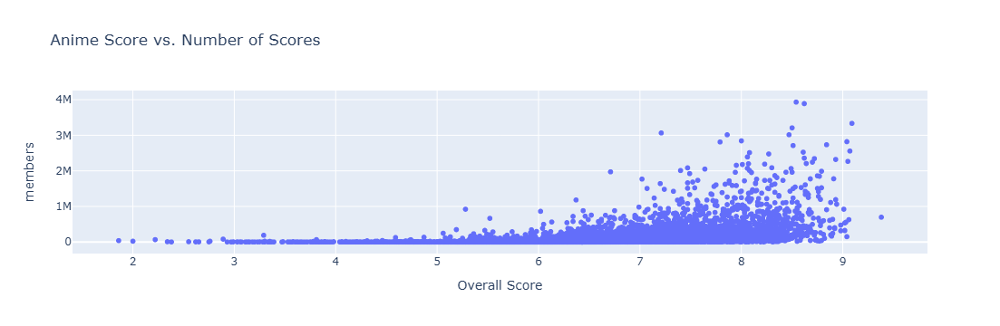

In [17]:
# Tạo biểu đồ phân tán đánh giá điểm số và số lượng của chúng
fig = px.scatter(df_anime, x='score', y='members', 
                 labels={'score':'Overall Score', 'Members':'Number of Scores'}, 
                 title='Anime Score vs. Number of Scores')

fig.show()

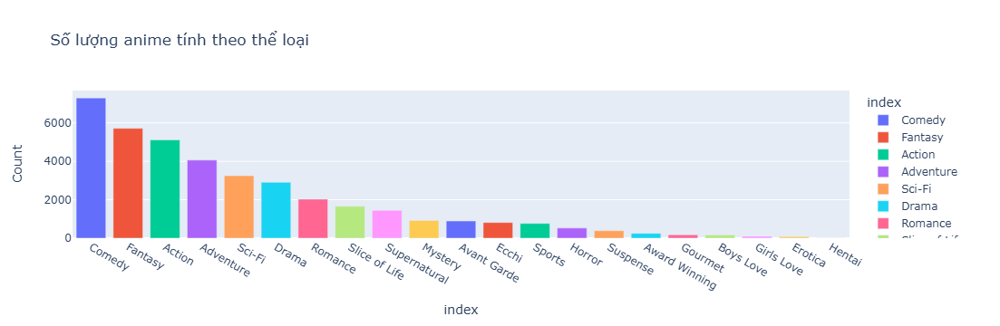

In [18]:
# Split the genres and count their occurrences
import ast

def convertToName(obj):
    L = []
    if (obj == "[]"):
        return "UNKNOWN"
    for i in ast.literal_eval(obj):
        L.append(i['name'])
    str = ", ".join(L)
    return str

df_anime['genres'] = df_anime['genres'].apply(convertToName)
genre_counts = df_anime[df_anime['genres'] != "UNKNOWN"]['genres'].apply(lambda x: x.split(', ')).explode().value_counts()
genre_counts = genre_counts[genre_counts.index != ""]
# Create a bar chart
fig = px.bar(genre_counts, x=genre_counts.index, y=genre_counts.values,
             labels={'x':'Genre', 'y':'Count'},
             title='Số lượng anime tính theo thể loại',
             color=genre_counts.index)

fig.show()

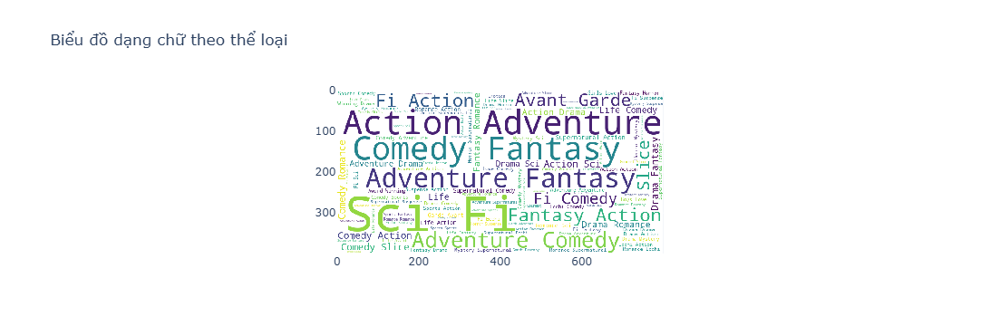

In [19]:
# Concatenate all genre values into a single string
genre_text = ' '.join(df_anime[df_anime['genres'] != "UNKNOWN"]['genres'].dropna())

# Create a WordCloud object
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(genre_text)

# Convert the WordCloud object to an image
wordcloud_image = wordcloud.to_image()

# Create a Plotly figure to display the WordCloud image
fig = go.Figure(go.Image(z=wordcloud_image))
fig.update_layout(title='Biểu đồ dạng chữ theo thể loại')
fig.show()

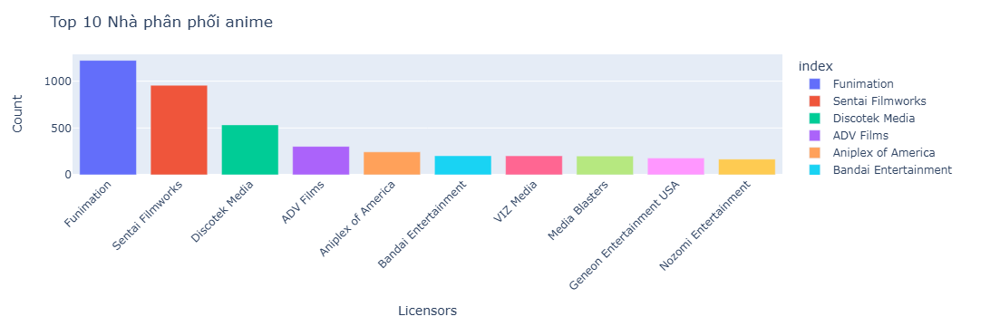

In [23]:
# Create a list of all the individual licensors
df_anime['licensors'] = df_anime['licensors'].apply(convertToName)
licensors_list = [licensor.strip() for licensors in df_anime[df_anime['licensors']!="UNKNOWN"]['licensors'].str.split(',') for licensor in licensors]

# Count the occurrences of each licensor
licensor_counts = pd.Series(licensors_list).value_counts()

# Filter the licensor_counts series to exclude 'Unknown'
filtered_licensor_counts = licensor_counts[licensor_counts.index != 'Unknown']

# Select the top 10 licensors
top_15_licensors = filtered_licensor_counts.head(10)

# Create the bar plot using Plotly
fig = px.bar(top_15_licensors, x=top_15_licensors.index, y=top_15_licensors.values, color=top_15_licensors.index)

# Customize the plot
fig.update_layout(
    title='Top 10 Nhà phân phối anime',
    xaxis_title='Licensors',
    yaxis_title='Count',
    xaxis_tickangle=-45
)

# Show the plot
fig.show()

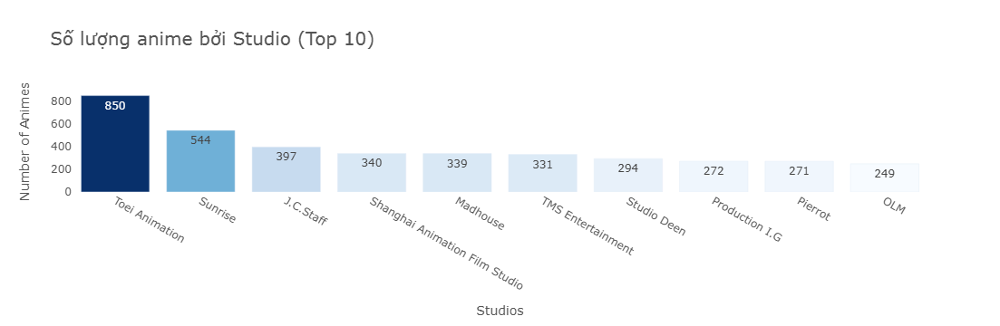

In [20]:
df_anime['studios'] = df_anime['studios'].apply(convertToName)
studio_counts = df_anime['studios'].value_counts()

studio_counts = studio_counts[studio_counts.index != 'UNKNOWN']

top_studios = studio_counts.head(10)

# Create the bar plot
fig = go.Figure(data=go.Bar(
    x=top_studios.index,
    y=top_studios.values,
    marker=dict(color=top_studios.values, colorscale='Blues'),  # Set the color of the bars using a colorscale
    text=top_studios.values,  # Set the text to be displayed on hover
    hovertemplate='Studio: %{x}<br>Number of Animes: %{y}<extra></extra>',  # Customize the hover template
))

# Set the title and axis labels
fig.update_layout(
    title='Số lượng anime bởi Studio (Top 10)',
    xaxis_title='Studios',
    yaxis_title='Number of Animes',
    title_font=dict(size=20),
    font=dict(size=12, color='#555555'),
    plot_bgcolor='rgba(0, 0, 0, 0)'  # Set the background color to transparent
)

fig.show()

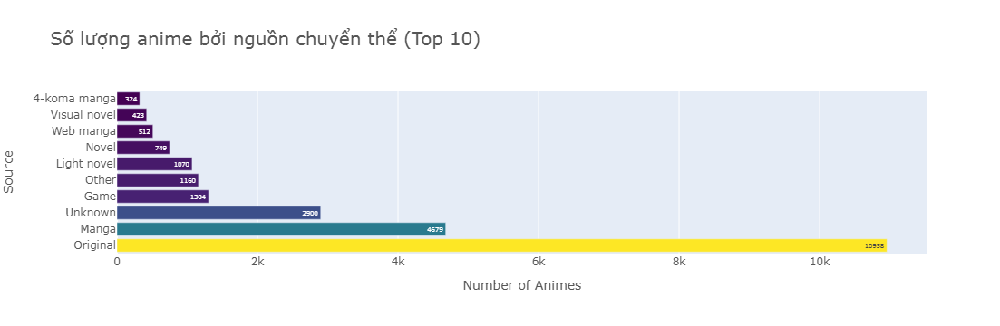

In [21]:
# Count the occurrences of each source
source_counts = df_anime['source'].value_counts()
df_anime['source'].fillna("UNKNOWN", inplace=True)

# Filter the source_counts series to exclude 'Unknown'
source_counts = source_counts[source_counts.index != 'UNKNOWN'].head(10)

# Create the horizontal bar chart
fig = go.Figure(data=go.Bar(
    x=source_counts.values,
    y=source_counts.index,
    orientation='h',  # Set the orientation to horizontal
    marker=dict(color=source_counts.values, colorscale='Viridis'),  # Set the color of the bars using a colorscale
    text=source_counts.values,  # Set the text to be displayed on hover
    hovertemplate='Source: %{y}<br>Number of Animes: %{x}<extra></extra>',  # Customize the hover template
))

# Set the title and axis labels
fig.update_layout(
    title='Số lượng anime bởi nguồn chuyển thể (Top 10)',
    xaxis_title='Number of Animes',
    yaxis_title='Source',
    title_font=dict(size=20),
    font=dict(size=12, color='#555555')
)

fig.show()

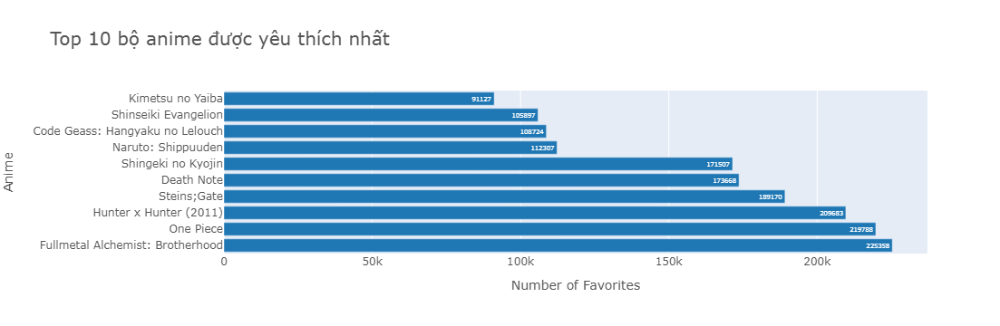

In [22]:
# Sort the DataFrame by the 'Favorites' column in descending order
sorted_df = df_anime.sort_values('favorites', ascending=False)

# Select the top 10 most favorited anime
top_favorites = sorted_df.head(10)

# Create the horizontal bar chart
fig = go.Figure(data=go.Bar(
    x=top_favorites['favorites'],
    y=top_favorites['title'],
    orientation='h',  # Set the orientation to horizontal
    marker=dict(color='#1f77b4'),  # Set the color of the bars
    text=top_favorites['favorites'],  # Set the text to be displayed on hover
    hovertemplate='Anime: %{y}<br>Favorites: %{x}<extra></extra>',  # Customize the hover template
))

# Set the title and axis labels
fig.update_layout(
    title='Top 10 bộ anime được yêu thích nhất',
    xaxis_title='Number of Favorites',
    yaxis_title='Anime',
    title_font=dict(size=20),
    font=dict(size=12, color='#555555')
)

fig.show()

### Dataset User

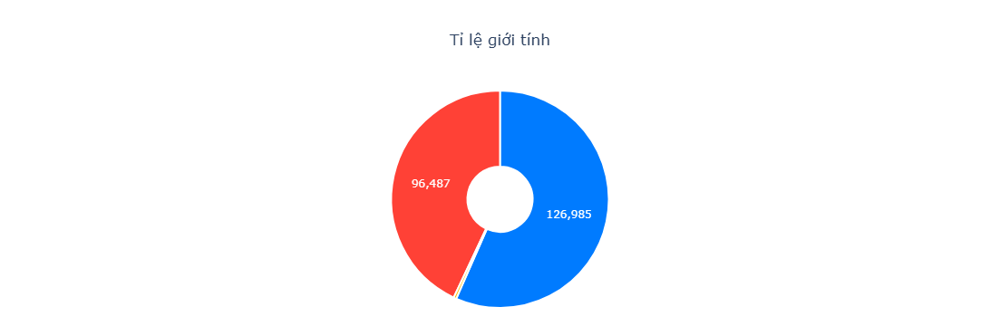

In [24]:
# Distribution of gender
# Count the occurrences of each gender
gender_counts = df_user['Gender'].value_counts(dropna=True)

# Define custom colors for the pie slices
colors = ['rgb(0, 123, 255)', 'rgb(255, 65, 54)', 'rgb(255, 187, 0)', 'rgb(125, 125, 125)']

# Create the pie plot
fig = go.Figure()

fig.add_trace(go.Pie(
    labels=gender_counts.index,
    values=gender_counts.values,
    hole=0.3,
    marker=dict(colors=colors, line=dict(color='#FFFFFF', width=2)),
    hoverinfo='label+percent',
    hovertemplate='<b>%{label}</b><br>%{percent}',
    textinfo='value',
    textposition='inside',
    sort=False
))

# Customize the layout
fig.update_layout(
    title='Tỉ lệ giới tính',
    title_x=0.5,
    uniformtext_minsize=12,
    uniformtext_mode='hide',
    showlegend=False,
    paper_bgcolor='rgba(0,0,0,0)',
    plot_bgcolor='rgba(0,0,0,0)',
    margin=dict(l=20, r=20, t=100, b=20),
)

# Show the plot
fig.show()

In [25]:
df_user['Birthday'].value_counts(dropna=True)

1990-01-01T00:00:00+00:00    177
1989-03-26T00:00:00+00:00    169
1980-01-01T00:00:00+00:00    166
1930-01-01T00:00:00+00:00    153
1991-01-01T00:00:00+00:00    115
                            ... 
1966-12-06T00:00:00+00:00      1
2001-11-08T00:00:00+00:00      1
1954-10-16T00:00:00+00:00      1
1958-03-13T00:00:00+00:00      1
2000-10-13T00:00:00+00:00      1
Name: Birthday, Length: 11247, dtype: int64

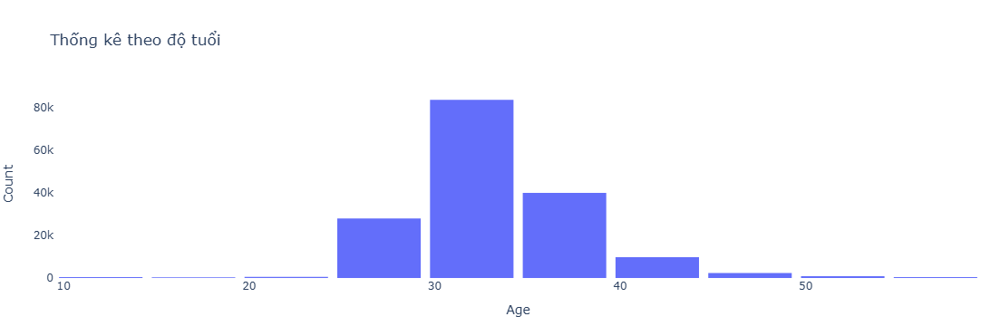

In [26]:
# Age Distribution
# Convert birthday to age
def calculate_age(birth_date):
    if birth_date != 'NaN':
        try:
            birth_year = int(birth_date.split('-')[0])
            today_year = datetime.utcnow().year
            age = today_year - birth_year
            if age >= 10 and age < 60:  # Valid age range (modify as needed)
                return age
            else:
                return None
        except:
            return None
    return None

# Apply age calculation to the 'Birthday' column
Age = df_user['Birthday'].dropna().apply(calculate_age)

# Create the histogram
fig = px.histogram(Age, nbins=20, title='Thống kê theo độ tuổi', labels={'value': 'Age', 'count': 'Count'})

# Customize the layout
fig.update_layout(
    xaxis=dict(title='Age'),
    yaxis=dict(title='Count'),
    bargap=0.1,
    showlegend=False,
    paper_bgcolor='rgba(0,0,0,0)',
    plot_bgcolor='rgba(0,0,0,0)',
    margin=dict(l=50, r=20, t=100, b=50),
)

# Show the plot
fig.show()

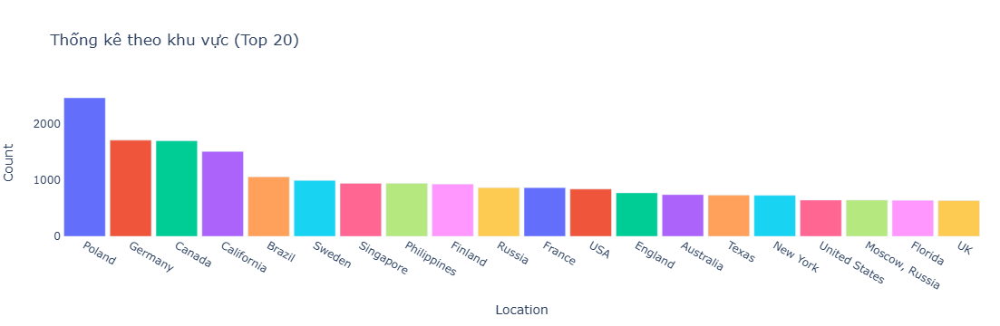

In [27]:
# Location analysis
# Count the occurrences of each location
location_counts = df_user['Location'].value_counts()

# Create a bar chart
fig = px.bar(location_counts.head(20),
             x=location_counts.head(20).index,
             y=location_counts.head(20).values,
             labels={'x': 'Location', 'y': 'Count'},
             title='Thống kê theo khu vực (Top 20)',
             color=location_counts.head(20).index)

# Customize the layout
fig.update_layout(
    xaxis=dict(title='Location'),
    yaxis=dict(title='Count'),
    bargap=0.1,
    showlegend=False,
    paper_bgcolor='rgba(0,0,0,0)',
    plot_bgcolor='rgba(0,0,0,0)',
    margin=dict(l=50, r=20, t=100, b=50),
)

# Show the plot
fig.show()

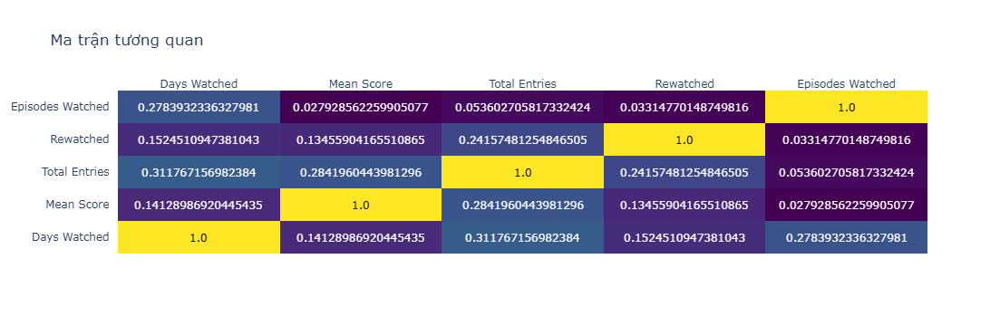

In [30]:
# Create a correlation matrix
correlation_matrix = df_user[['Days Watched', 'Mean Score', 'Total Entries', 'Rewatched', 'Episodes Watched']].corr()

# Create a heatmap of the correlation matrix
fig = ff.create_annotated_heatmap(z=correlation_matrix.values,
                                  x=list(correlation_matrix.columns),
                                  y=list(correlation_matrix.index),
                                  colorscale='Viridis')
fig.update_layout(title='Ma trận tương quan')
fig.show()

### Dataset User Score

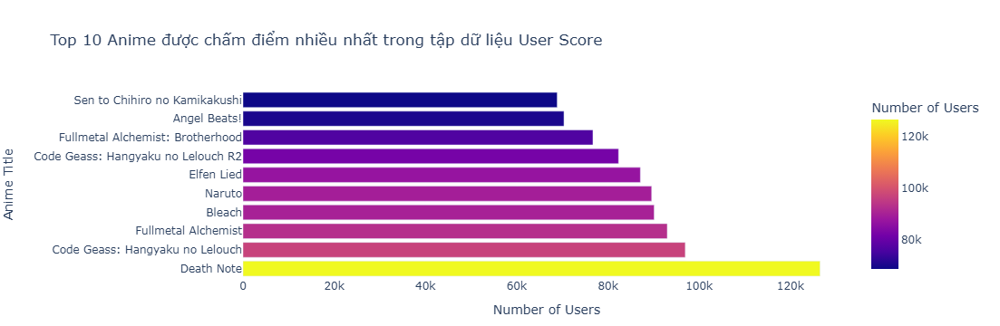

In [28]:
# Animes that was watched by most users in the df_score dataset

# Get the count of users who watched each anime title
anime_watch_count = df_score.groupby('Anime Title')['user_id'].nunique().reset_index()
anime_watch_count = anime_watch_count.rename(columns={'user_id': 'User Count'})

# Sort the dataframe in descending order by the number of users
anime_watch_count = anime_watch_count.sort_values(by='User Count', ascending=False)

# Select the top 10 anime titles with the highest number of users
top_n = 10
top_anime_watch_count = anime_watch_count.head(top_n)

# Define a colorful color palette
color_palette = px.colors.qualitative.Plotly

# Create the bar chart with colorful bars
fig = px.bar(top_anime_watch_count, x='User Count', y='Anime Title', orientation='h',
             title=f'Top {top_n} Anime được chấm điểm nhiều nhất trong tập dữ liệu User Score',
             labels={'User Count': 'Number of Users', 'Anime Title': 'Anime Title'},
             color='User Count',
             color_discrete_sequence=color_palette)

# Customize the layout
fig.update_layout(showlegend=False, paper_bgcolor='rgba(0,0,0,0)', plot_bgcolor='rgba(0,0,0,0)',
                  margin=dict(l=50, r=20, t=100, b=50))

# Show the plot
fig.show()